In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm
import plotly.express as px
import plotly.graph_objects as go
import  seaborn as sns
from sklearn.neighbors import LocalOutlierFactor

### Conectar a drive

In [3]:
"""from google.colab import drive
drive.mount('/content/drive')"""

"from google.colab import drive\ndrive.mount('/content/drive')"

## Lectura de Datos

In [4]:
df = pd.read_excel('Crydata1.xlsx', sheet_name='Rend_2019_04')
df = df.iloc[1:]
std = ['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r']
std_dev = np.std(df[std])
print("Desviación estándar para todos los datos en la tabla: ", std_dev)
df.head()

Desviación estándar para todos los datos en la tabla:  btc_r     0.007364
eth_r     0.009032
xrp_r     0.011816
xlm_r     0.011936
ltc_r     0.010470
ada_r     0.011226
bnb_r     0.009661
trx_r     0.010597
eos_r     0.010981
iota_r    0.012144
neo_r     0.011865
dtype: float64


c:\Users\Pc\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3643: FutureWarning: The behavior of DataFrame.std with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return std(axis=axis, dtype=dtype, out=out, ddof=ddof, **kwargs)


,date,btc_c,eth_c,xrp_c,xlm_c,ltc_c,ada_c,bnb_c,trx_c,eos_c,...,eth_r,xrp_r,xlm_r,ltc_r,ada_r,bnb_r,trx_r,eos_r,iota_r,neo_r
1,2019-05-01 00:00:00,5335.62,162.69,0.45950,0.19988,74.34,0.06974,21.9893,0.03671,4.7884,...,0.005314,-0.001976,-0.002495,0.000269,-0.005136,-0.002260,0.002458,-0.005710,-0.002323,0.005345
2,2019-05-01 01:00:00,5338.85,161.79,0.46014,0.19996,73.62,0.06985,22.0682,0.03729,4.7782,...,-0.005532,0.001393,0.000400,-0.009685,0.001577,0.003588,0.015800,-0.002130,0.001331,-0.003169
3,2019-05-01 02:00:00,5355.07,162.10,0.46135,0.19824,73.80,0.06948,21.9607,0.03701,4.7896,...,0.001916,0.002630,-0.008602,0.002445,-0.005297,-0.004871,-0.007509,0.002386,-0.001993,-0.002462
4,2019-05-01 03:00:00,5348.95,161.53,0.45657,0.19632,73.49,0.06930,21.9415,0.03678,4.7732,...,-0.003516,-0.010361,-0.009685,-0.004201,-0.002591,-0.000874,-0.006215,-0.003424,-0.004660,-0.006683
5,2019-05-01 04:00:00,5341.13,160.78,0.45564,0.19448,73.57,0.06851,21.8718,0.03677,4.7631,...,-0.004643,-0.002037,-0.009372,0.001089,-0.011400,-0.003177,-0.000272,-0.002116,-0.001338,-0.003416


Diario

In [5]:
# Seleccionar solo las columnas de interés

df_selected = df[['date', 'btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r',]]



In [6]:
df_day = df_selected.resample('D', on='date').mean()
df_day.reset_index(inplace=True)
df_day['date'] = pd.to_datetime(df_day['date'], format='%d/%m/%Y')

std_dev2 = np.std(df_day[std])
print("Desviación estándar para todos los datos en la tabla: ", std_dev2)

df_day.head()

Desviación estándar para todos los datos en la tabla:  btc_r     0.001516
eth_r     0.001918
xrp_r     0.002414
xlm_r     0.002344
ltc_r     0.002059
ada_r     0.002209
bnb_r     0.002058
trx_r     0.002059
eos_r     0.002295
iota_r    0.002324
neo_r     0.002331
dtype: float64


c:\Users\Pc\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3643: FutureWarning: The behavior of DataFrame.std with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return std(axis=axis, dtype=dtype, out=out, ddof=ddof, **kwargs)


,date,btc_r,eth_r,xrp_r,xlm_r,ltc_r,ada_r,bnb_r,trx_r,eos_r,iota_r,neo_r
0,2019-05-01,0.000489,-0.000416,0.002560,0.002551,-0.000516,-0.000756,-0.000298,0.003097,-0.000458,-0.000942,-0.000097
1,2019-05-02,0.000845,0.000426,-0.000532,-0.001693,0.000190,-0.000132,0.003229,-0.001496,0.000196,-0.001075,0.000570
2,2019-05-03,0.002090,0.001605,0.000719,0.001377,0.003143,0.000909,0.000178,0.000820,0.002629,0.000198,0.000442
3,2019-05-04,0.000436,-0.001076,-0.002457,-0.002520,-0.000709,-0.001820,-0.001418,-0.003987,-0.001103,-0.000543,-0.002033
4,2019-05-05,-0.000378,-0.000153,0.000940,0.001818,-0.001104,-0.000508,0.000173,0.000696,-0.000564,-0.000195,-0.000932


Semanal

In [7]:
df_sem = df_selected.resample('W', on='date').mean()
std_dev3 = np.std(df_sem[std])
print("Desviación estándar para todos los datos en la tabla: ", std_dev3)
df_sem.reset_index(inplace=True)
df_sem.head()

Desviación estándar para todos los datos en la tabla:  btc_r     0.000531
eth_r     0.000672
xrp_r     0.000869
xlm_r     0.000900
ltc_r     0.000750
ada_r     0.000813
bnb_r     0.000807
trx_r     0.000715
eos_r     0.000805
iota_r    0.000880
neo_r     0.000902
dtype: float64


c:\Users\Pc\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3643: FutureWarning: The behavior of DataFrame.std with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return std(axis=axis, dtype=dtype, out=out, ddof=ddof, **kwargs)


,date,btc_r,eth_r,xrp_r,xlm_r,ltc_r,ada_r,bnb_r,trx_r,eos_r,iota_r,neo_r
0,2019-05-05,0.000696,0.000077,0.000246,0.000307,0.000201,-0.000461,0.000373,-0.000174,0.000140,-0.000511,-0.000410
1,2019-05-12,0.001148,0.000919,-0.000460,-0.000101,0.000762,0.000451,-0.000474,-0.000413,0.000589,0.000407,0.000127
2,2019-05-19,0.001062,0.002195,0.000019,0.001902,0.000815,0.001458,0.002211,0.000365,0.001315,0.002375,0.001587
3,2019-05-26,0.000360,0.000151,0.000365,0.001303,0.001006,-0.000019,0.000824,0.000489,0.000391,-0.000175,0.000157
4,2019-06-02,0.000098,0.000148,-0.000227,-0.001232,0.000233,0.000809,0.000056,-0.001112,0.000827,0.001239,0.001149


Mensual

In [8]:
df_mes = df_selected.resample('M', on='date').mean()
std_dev4 = np.std(df_mes[std])
print("Desviación estándar para todos los datos en la tabla: ", std_dev4)
df_mes  .reset_index(inplace=True)
df_mes.head()

Desviación estándar para todos los datos en la tabla:  btc_r     0.000267
eth_r     0.000332
xrp_r     0.000515
xlm_r     0.000453
ltc_r     0.000307
ada_r     0.000475
bnb_r     0.000463
trx_r     0.000341
eos_r     0.000326
iota_r    0.000417
neo_r     0.000389
dtype: float64


C:\Users\Pc\AppData\Local\Temp\ipykernel_36404\24609628.py:1: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  df_mes = df_selected.resample('M', on='date').mean()
c:\Users\Pc\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3643: FutureWarning: The behavior of DataFrame.std with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return std(axis=axis, dtype=dtype, out=out, ddof=ddof, **kwargs)


,date,btc_r,eth_r,xrp_r,xlm_r,ltc_r,ada_r,bnb_r,trx_r,eos_r,iota_r,neo_r
0,2019-05-31,0.000682,0.000757,-0.000045,0.000488,0.000667,0.000413,0.000617,-0.000146,0.000854,0.000813,0.000542
1,2019-06-30,0.000383,0.000159,-0.000302,-0.000176,0.000163,-0.000054,0.000006,-0.000192,-0.000483,-0.000313,0.000384
2,2019-07-31,-0.000038,-0.000332,0.000984,0.000316,-0.000226,-0.000348,-0.000134,-0.000125,-0.000284,-0.000346,-0.000393
3,2019-08-31,-0.000045,-0.000303,-0.000296,-0.000162,-0.000549,-0.000363,-0.000350,0.000058,-0.000356,-0.000188,-0.000363
4,2019-09-30,-0.000182,0.000110,-0.000194,-0.000316,-0.000149,-0.000142,-0.000358,-0.000423,-0.000104,0.000147,-0.000165


3 Meses

In [9]:
df_3mes = df_selected.resample('3M', on='date').mean()
std = ['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r']
std_dev5 = np.std(df_3mes[std])
print("Desviación estándar para todos los datos en la tabla: ", std_dev5)
df_3mes.reset_index(inplace=True)
df_3mes.head()

Desviación estándar para todos los datos en la tabla:  btc_r     0.000194
eth_r     0.000220
xrp_r     0.000234
xlm_r     0.000286
ltc_r     0.000208
ada_r     0.000296
bnb_r     0.000302
trx_r     0.000221
eos_r     0.000264
iota_r    0.000273
neo_r     0.000213
dtype: float64


C:\Users\Pc\AppData\Local\Temp\ipykernel_36404\516934055.py:1: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  df_3mes = df_selected.resample('3M', on='date').mean()
c:\Users\Pc\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3643: FutureWarning: The behavior of DataFrame.std with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return std(axis=axis, dtype=dtype, out=out, ddof=ddof, **kwargs)


,date,btc_r,eth_r,xrp_r,xlm_r,ltc_r,ada_r,bnb_r,trx_r,eos_r,iota_r,neo_r
0,2019-05-31,0.000682,0.000757,-0.000045,0.000488,0.000667,0.000413,0.000617,-0.000146,0.000854,0.000813,0.000542
1,2019-08-31,0.000098,-0.000161,0.000135,-0.000005,-0.000207,-0.000257,-0.000161,-0.000086,-0.000373,-0.000283,-0.000129
2,2019-11-30,-0.000088,-0.000030,-0.000112,-0.000379,-0.000107,-0.000010,-0.000100,0.000179,-0.000046,-0.000042,0.000078
3,2020-02-29,0.000070,0.000195,0.000013,0.000135,0.000140,0.000112,0.000126,-0.000006,0.000164,0.000058,0.000123
4,2020-05-31,0.000127,0.000123,0.000078,-0.000023,-0.000024,0.000302,0.000045,0.000052,-0.000038,0.000130,0.000088


6 Meses

In [10]:
df_6mes = df_selected.resample('6M', on='date').mean()
std = ['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r']
std_dev6 = np.std(df_6mes[std])
print("Desviación estándar para todos los datos en la tabla: ", std_dev6)
df_6mes.reset_index(inplace=True)
df_6mes.head()

Desviación estándar para todos los datos en la tabla:  btc_r     0.000205
eth_r     0.000248
xrp_r     0.000111
xlm_r     0.000200
ltc_r     0.000225
ada_r     0.000246
bnb_r     0.000268
trx_r     0.000103
eos_r     0.000282
iota_r    0.000282
neo_r     0.000206
dtype: float64


C:\Users\Pc\AppData\Local\Temp\ipykernel_36404\3154622997.py:1: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  df_6mes = df_selected.resample('6M', on='date').mean()
c:\Users\Pc\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3643: FutureWarning: The behavior of DataFrame.std with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return std(axis=axis, dtype=dtype, out=out, ddof=ddof, **kwargs)


,date,btc_r,eth_r,xrp_r,xlm_r,ltc_r,ada_r,bnb_r,trx_r,eos_r,iota_r,neo_r
0,2019-05-31,0.000682,0.000757,-0.000045,0.000488,0.000667,0.000413,0.000617,-0.000146,0.000854,0.000813,0.000542
1,2019-11-30,0.000005,-0.000096,0.000012,-0.000191,-0.000157,-0.000134,-0.000130,0.000046,-0.000210,-0.000163,-0.000026
2,2020-05-31,0.000099,0.000159,0.000046,0.000056,0.000058,0.000207,0.000085,0.000023,0.000062,0.000094,0.000105
3,2020-11-30,0.000181,0.000253,-0.000027,-0.000019,0.000189,0.000254,0.000178,0.000017,0.000084,0.000161,0.000183
4,2021-05-31,0.000204,0.000434,0.000079,0.000179,0.000315,0.000701,0.000697,0.000062,0.000335,0.000468,0.000434


1 año

In [11]:
df_ano = df_selected.resample('Y', on='date').mean()
std = ['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r']
std_dev7 = np.std(df_ano[std])
print("Desviación estándar para todos los datos en la tabla: ", std_dev7)
df_ano.reset_index(inplace=True)
df_ano.head()

Desviación estándar para todos los datos en la tabla:  btc_r     0.000110
eth_r     0.000135
xrp_r     0.000065
xlm_r     0.000143
ltc_r     0.000087
ada_r     0.000171
bnb_r     0.000174
trx_r     0.000066
eos_r     0.000088
iota_r    0.000161
neo_r     0.000097
dtype: float64


C:\Users\Pc\AppData\Local\Temp\ipykernel_36404\2616450556.py:1: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  df_ano = df_selected.resample('Y', on='date').mean()
c:\Users\Pc\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3643: FutureWarning: The behavior of DataFrame.std with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return std(axis=axis, dtype=dtype, out=out, ddof=ddof, **kwargs)


,date,btc_r,eth_r,xrp_r,xlm_r,ltc_r,ada_r,bnb_r,trx_r,eos_r,iota_r,neo_r
0,2019-12-31,0.000083,-0.000002,0.000008,-6.406128e-05,-0.000054,-0.000081,-0.000041,-0.000002,-0.000058,-0.000063,0.000039
1,2020-12-31,0.000191,0.000247,0.000003,7.019331e-07,0.000185,0.000266,0.000168,0.000024,0.000058,0.000143,0.000125
2,2021-12-31,0.000096,0.000252,0.000190,3.400952e-04,0.000118,0.000340,0.000395,0.000206,0.000137,0.000327,0.000195
3,2022-12-31,-0.000094,-0.000086,0.000073,-9.513915e-05,-0.000037,-0.000139,-0.000051,0.000078,-0.000095,-0.000186,-0.000110
4,2023-12-31,0.000117,0.000086,0.000099,9.408017e-05,0.000030,0.000129,0.000041,0.000090,0.000027,0.000107,0.000137


Exportar a excel

In [12]:
"""""
with pd.ExcelWriter('nombre_archivo_multiple.xlsx') as writer:
   df_day.to_excel(writer, sheet_name='Hoja1', index=False)  # Exporta df1 a la Hoja1
   df_sem.to_excel(writer, sheet_name='Hoja2', index=False)  # Exporta df2 a la Hoja2
   df_mes.to_excel(writer, sheet_name='Hoja3', index=False)  # Exporta df3 a la Hoja3
   df_3mes.to_excel(writer, sheet_name='Hoja4', index=False)  # Exporta df1 a la Hoja1
   df_6mes.to_excel(writer, sheet_name='Hoja5', index=False)  # Exporta df2 a la Hoja2
   df_ano.to_excel(writer, sheet_name='Hoja6', index=False)
"""

'""\nwith pd.ExcelWriter(\'nombre_archivo_multiple.xlsx\') as writer:\n   df_day.to_excel(writer, sheet_name=\'Hoja1\', index=False)  # Exporta df1 a la Hoja1\n   df_sem.to_excel(writer, sheet_name=\'Hoja2\', index=False)  # Exporta df2 a la Hoja2\n   df_mes.to_excel(writer, sheet_name=\'Hoja3\', index=False)  # Exporta df3 a la Hoja3\n   df_3mes.to_excel(writer, sheet_name=\'Hoja4\', index=False)  # Exporta df1 a la Hoja1\n   df_6mes.to_excel(writer, sheet_name=\'Hoja5\', index=False)  # Exporta df2 a la Hoja2\n   df_ano.to_excel(writer, sheet_name=\'Hoja6\', index=False)\n'

Datos estandarizados

In [13]:
import pandas as pd
from sklearn.preprocessing import StandardScaler

# Suponiendo que ya tienes cargada la base de datos original df con las variables date, btc_r, eth_r, xrp_r, xl

# Crear un objeto StandardScaler
scaler = StandardScaler()

# Seleccionar las columnas numéricas a estandarizar
columns_to_standardize = ['btc_c', 'eth_c', 'xrp_c', 'xlm_c', 'ltc_c', 'ada_c', 'bnb_c', 'trx_c', 'eos_c', 'iota_c', 'neo_c']

# Estandarizar las columnas seleccionadas
df_standardized = df.copy()  # Crear una copia del dataframe original
df_standardized[columns_to_standardize] = scaler.fit_transform(df[columns_to_standardize])
df_standardized.reset_index(inplace=True)
# Aquí df_standardized contendrá los datos estandarizados de las columnas seleccionadas
df_standardized.head()


,index,date,btc_c,eth_c,xrp_c,xlm_c,ltc_c,ada_c,bnb_c,trx_c,...,eth_r,xrp_r,xlm_r,ltc_r,ada_r,bnb_r,trx_r,eos_r,iota_r,neo_r
0,1,2019-05-01 00:00:00,-1.338091,-1.194361,-0.067230,0.320488,-0.401675,-0.805270,-1.160737,-0.406565,...,0.005314,-0.001976,-0.002495,0.000269,-0.005136,-0.002260,0.002458,-0.005710,-0.002323,0.005345
1,2,2019-05-01 01:00:00,-1.337892,-1.195132,-0.064949,0.321146,-0.414843,-0.805090,-1.160280,-0.390055,...,-0.005532,0.001393,0.000400,-0.009685,0.001577,0.003588,0.015800,-0.002130,0.001331,-0.003169
2,3,2019-05-01 02:00:00,-1.336897,-1.194867,-0.060636,0.306994,-0.411551,-0.805697,-1.160903,-0.398025,...,0.001916,0.002630,-0.008602,0.002445,-0.005297,-0.004871,-0.007509,0.002386,-0.001993,-0.002462
3,4,2019-05-01 03:00:00,-1.337272,-1.195355,-0.077671,0.291197,-0.417221,-0.805992,-1.161014,-0.404573,...,-0.003516,-0.010361,-0.009685,-0.004201,-0.002591,-0.000874,-0.006215,-0.003424,-0.004660,-0.006683
4,5,2019-05-01 04:00:00,-1.337752,-1.195997,-0.080986,0.276058,-0.415758,-0.807289,-1.161418,-0.404857,...,-0.004643,-0.002037,-0.009372,0.001089,-0.011400,-0.003177,-0.000272,-0.002116,-0.001338,-0.003416


In [14]:
fig = px.line(df_standardized, x='date', y=['btc_c', 'eth_c', 'xrp_c', 'xlm_c', 'ltc_c', 'ada_c', 'bnb_c', 'trx_c', 'eos_c', 'iota_c', 'neo_c'],
              title='Rendimientos horarios anuales pomedio',
              labels={'value': 'Valor', 'date': 'Fecha'},
              width=1000, height=600)
fig.show()

Todas las graficas

In [15]:
fig = px.line(df, x='date', y=['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r'],
            title='Rendimientos horarios de criptomonedas')

fig.show(render='browser')


In [16]:

# Crear el gráfico de líneas con Plotly Express

fig = px.line(df_day, x='date', y=['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r'],
              title='Rendimientos horarios diarios promedio',
              labels={'value': 'Valor', 'date': 'Fecha'},
              width=1000, height=600)
"""std_dev = df_day['std_all']
mean_values = df_day[['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r']].mean(axis=1)
upper_bound = mean_values + std_dev
lower_bound = mean_values - std_dev

# Añadir las desviaciones estándar por encima y por debajo al gráfico
fig.add_trace(go.Scatter(x=df_day['date'].tolist() + df_day['date'].tolist()[::-1],
                         y=upper_bound.tolist() + lower_bound.tolist()[::-1],
                         fill='toself',
                         fillcolor='rgba(0,100,80,0.2)',
                         line=dict(color='rgba(255,255,255,0)'),
                         name='Desviación Estándar'))"""
# Mostrar el gráfico
fig.show()


In [17]:
fig = px.line(df_sem, x='date', y=['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r'],
              title='Rendimientos horarios semanales promedio',
              labels={'value': 'Valor', 'date': 'Fecha'},
              width=1000, height=600)
"""std_dev = df_sem['std_all']
mean_values = df_sem[['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r']].mean(axis=1)
upper_bound = mean_values + std_dev
lower_bound = mean_values - std_dev

# Añadir las desviaciones estándar por encima y por debajo al gráfico
fig.add_trace(go.Scatter(x=df_sem['date'].tolist() + df_sem['date'].tolist()[::-1],
                         y=upper_bound.tolist() + lower_bound.tolist()[::-1],
                         fill='toself',
                         fillcolor='rgba(0,100,80,0.2)',
                         line=dict(color='rgba(255,255,255,0)'),
                         name='Desviación Estándar'))
# Mostrar el gráfico"""
fig.show()

In [18]:
fig = px.line(df_mes, x='date', y=['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r'],
              title='Rendimientos horarios mensuale promedio',
              labels={'value': 'Valor', 'date': 'Fecha'},
              width=1000, height=600)

# Mostrar el gráfico
fig.show()

In [19]:
fig = px.line(df_3mes, x='date', y=['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r'],
              title='Rendimientos horarios promedio cada 3 meses',
              labels={'value': 'Valor', 'date': 'Fecha'},
              width=1000, height=600)


# Mostrar el gráfico
fig.show()

In [20]:
fig = px.line(df_6mes, x='date', y=['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r'],
              title='Rendimientos horarios promedio cada 6 meses',
              labels={'value': 'Valor', 'date': 'Fecha'},
              width=1000, height=600)


# Mostrar el gráfico
fig.show()

In [21]:


fig = px.line(df_ano, x='date', y=['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r'],
              title='Rendimientos horarios anuales pomedio',
              labels={'value': 'Valor', 'date': 'Fecha'},
              width=1000, height=600)


# Mostrar el gráfico
fig.show()


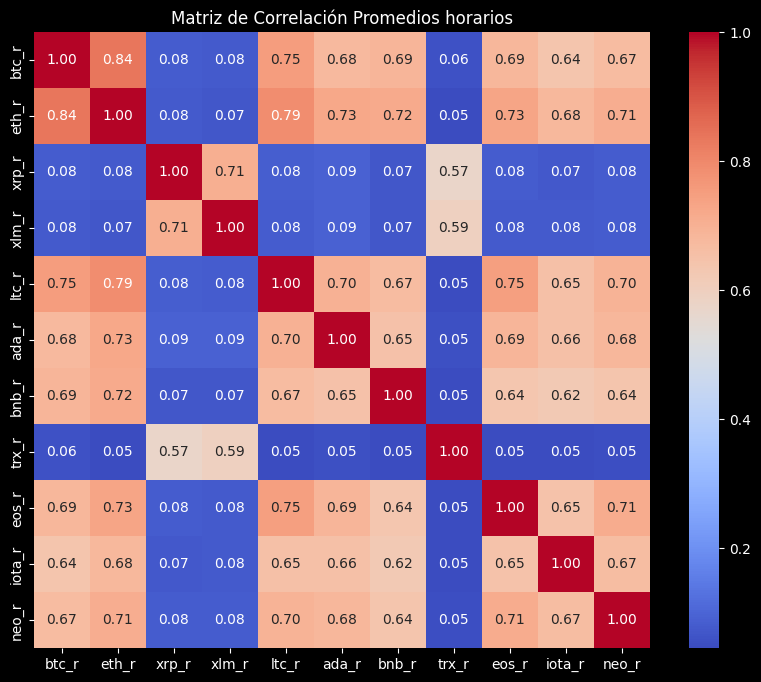

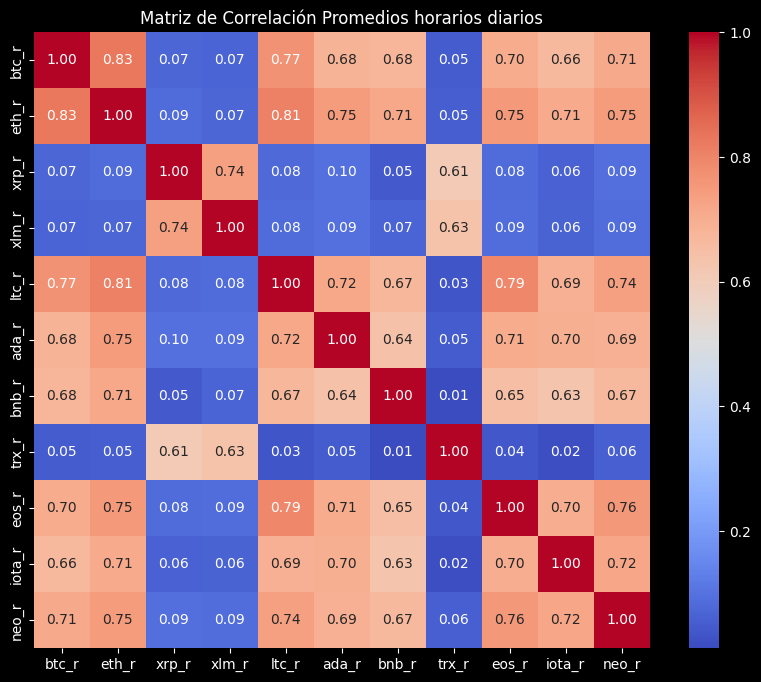

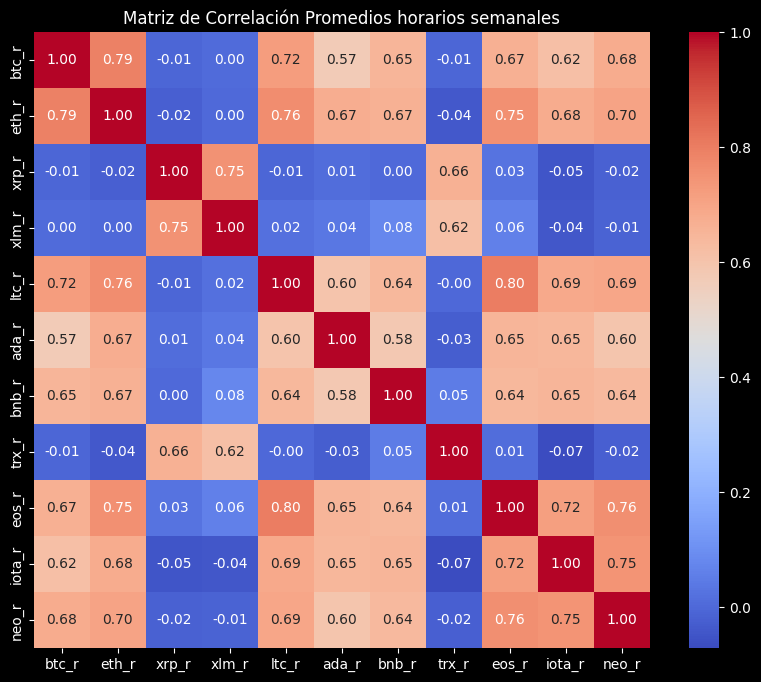

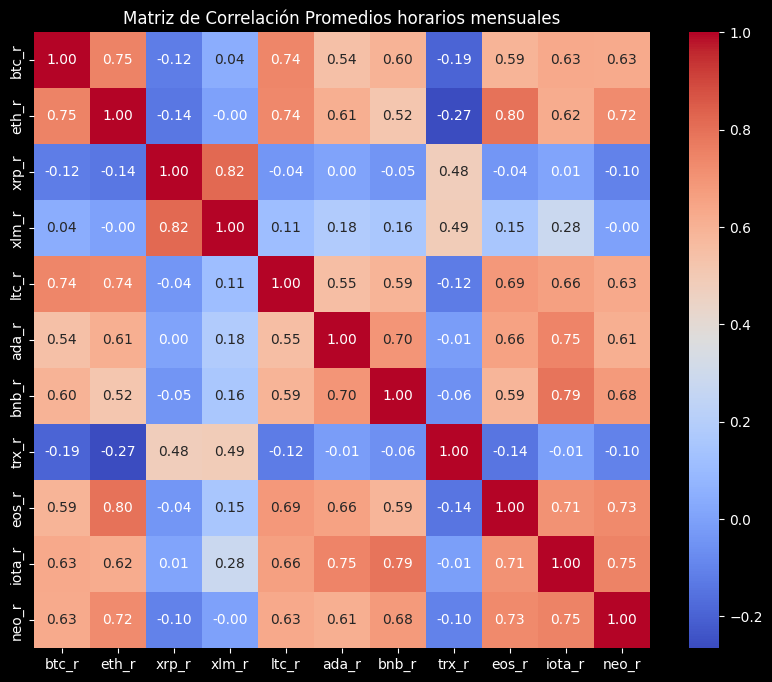

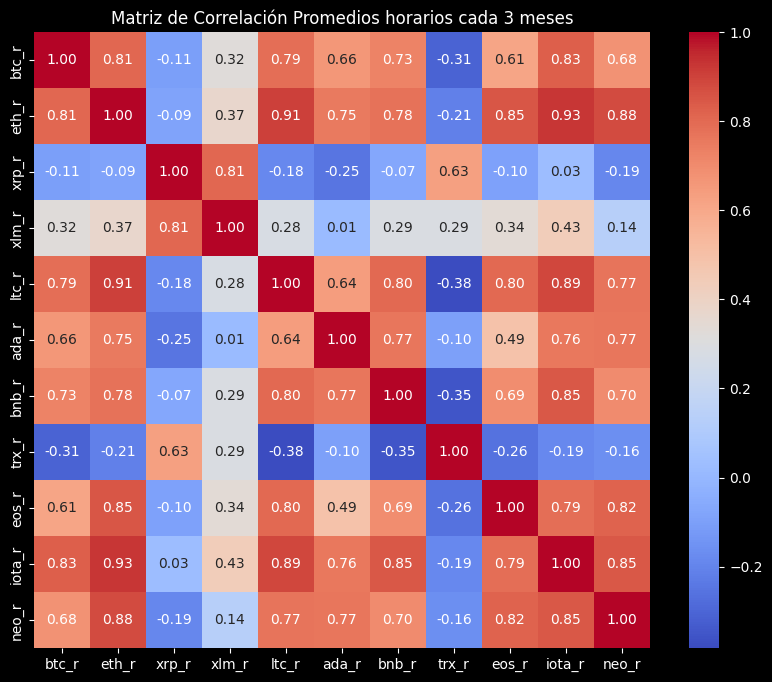

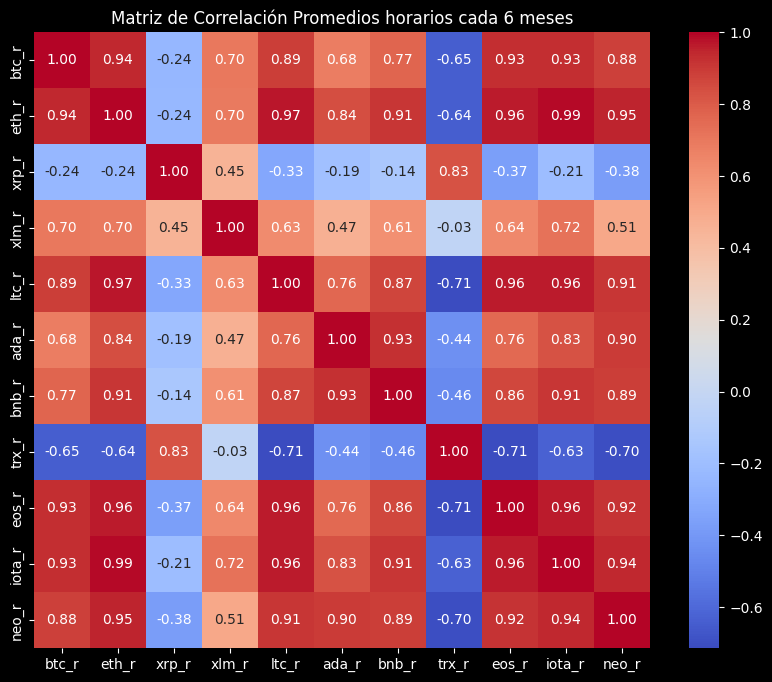

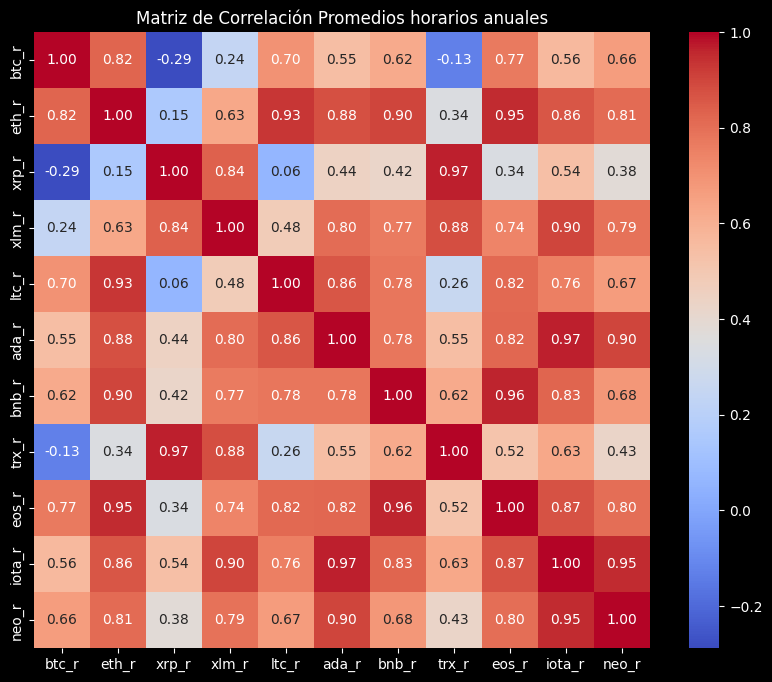

In [22]:
columns = ['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r']

# Seleccionar las columnas relevantes para el cálculo de la correlación
columns = ['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r']

# Calcular la matriz de correlación
correlation_matrix = df[columns].corr()

# Crear un mapa de calor para visualizar la correlación
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title('Matriz de Correlación Promedios horarios')
plt.show()


# Calcular la matriz de correlación
correlation_matrix2 = df_day[columns].corr()

# Crear un mapa de calor para visualizar la correlación
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix2, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title('Matriz de Correlación Promedios horarios diarios')
plt.show()


# Calcular la matriz de correlación
correlation_matrix3 = df_sem[columns].corr()

# Crear un mapa de calor para visualizar la correlación
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix3, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title('Matriz de Correlación Promedios horarios semanales')
plt.show()


# Calcular la matriz de correlación
correlation_matrix4 = df_mes[columns].corr()

# Crear un mapa de calor para visualizar la correlación
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix4, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title('Matriz de Correlación Promedios horarios mensuales')
plt.show()



# Calcular la matriz de correlación
correlation_matrix5 = df_3mes[columns].corr()

# Crear un mapa de calor para visualizar la correlación
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix5, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title('Matriz de Correlación Promedios horarios cada 3 meses')
plt.show()



# Calcular la matriz de correlación
correlation_matrix6 = df_6mes[columns].corr()

# Crear un mapa de calor para visualizar la correlación
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix6, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title('Matriz de Correlación Promedios horarios cada 6 meses')
plt.show()


# Calcular la matriz de correlación
correlation_matrix7 = df_ano[columns].corr()

# Crear un mapa de calor para visualizar la correlación
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix7, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title('Matriz de Correlación Promedios horarios anuales')
plt.show()

Fechas Importantes Dia

In [23]:
data_day = df_day[['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r']]
print(data_day)

         btc_r     eth_r     xrp_r     xlm_r     ltc_r     ada_r     bnb_r  \
0     0.000489 -0.000416  0.002560  0.002551 -0.000516 -0.000756 -0.000298   
1     0.000845  0.000426 -0.000532 -0.001693  0.000190 -0.000132  0.003229   
2     0.002090  0.001605  0.000719  0.001377  0.003143  0.000909  0.000178   
3     0.000436 -0.001076 -0.002457 -0.002520 -0.000709 -0.001820 -0.001418   
4    -0.000378 -0.000153  0.000940  0.001818 -0.001104 -0.000508  0.000173   
...        ...       ...       ...       ...       ...       ...       ...   
1781 -0.002578 -0.002495 -0.002067 -0.002348 -0.002655 -0.004054 -0.003841   
1782  0.002041  0.001525  0.001173  0.001033  0.000975  0.001527 -0.000284   
1783 -0.000485 -0.001487  0.001857  0.000910  0.000472 -0.001307 -0.001190   
1784 -0.003747 -0.004606 -0.004204 -0.004661 -0.004269 -0.005005 -0.003762   
1785  0.004012  0.004784  0.001961  0.003528  0.003360  0.003886  0.004090   

         trx_r     eos_r    iota_r     neo_r  
0     0.003097 -

In [24]:
lof = LocalOutlierFactor(n_neighbors=20, contamination=0.1)  # Puedes ajustar los parámetros según tus necesidades

# Ajustar el modelo a tus datos
outliers = lof.fit_predict(data_day)

# Agregar la columna de outliers al dataframe original
df_day['outliers'] = outliers

# Filtrar las fechas con outliers
data_rel_day = df_day[df_day['outliers'] == -1]['date']

# Imprimir las fechas de mayor volatilidad detectadas como outliers de forma elegante
# Convert datetime objects to strings
fechas_outliers_str = data_rel_day.dt.strftime('%Y-%m-%d')
print(data_rel_day)
# Print the dates of highest volatility detected as outliers in a fancy grid table
"""print(tabulate(fechas_outliers_str, headers='keys', tablefmt='fancy_grid', showindex=False))"""

8      2019-05-09
12     2019-05-13
14     2019-05-15
16     2019-05-17
17     2019-05-18
          ...    
1767   2024-03-02
1769   2024-03-04
1772   2024-03-07
1776   2024-03-11
1778   2024-03-13
Name: date, Length: 179, dtype: datetime64[ns]


"print(tabulate(fechas_outliers_str, headers='keys', tablefmt='fancy_grid', showindex=False))"

Fechas Importantes Semana

In [25]:
data_sem = df_sem[['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r']]
print(data_sem)

        btc_r     eth_r     xrp_r     xlm_r     ltc_r     ada_r     bnb_r  \
0    0.000696  0.000077  0.000246  0.000307  0.000201 -0.000461  0.000373   
1    0.001148  0.000919 -0.000460 -0.000101  0.000762  0.000451 -0.000474   
2    0.001062  0.002195  0.000019  0.001902  0.000815  0.001458  0.002211   
3    0.000360  0.000151  0.000365  0.001303  0.001006 -0.000019  0.000824   
4    0.000098  0.000148 -0.000227 -0.001232  0.000233  0.000809  0.000056   
..        ...       ...       ...       ...       ...       ...       ...   
251 -0.000040  0.000477 -0.000145  0.000054 -0.000044 -0.000241  0.000643   
252  0.001207  0.000700  0.000904  0.000935  0.001601  0.001296  0.000401   
253  0.000558  0.000678 -0.000131  0.000256 -0.000151  0.000012  0.001511   
254 -0.000018 -0.000336  0.000205 -0.000256 -0.000030 -0.000226  0.000538   
255 -0.000073 -0.000436 -0.000129 -0.000074 -0.000146 -0.000809 -0.000287   

        trx_r     eos_r    iota_r         neo_r  
0   -0.000174  0.000140 -

In [26]:
lof = LocalOutlierFactor(n_neighbors=20, contamination=0.1)  # Puedes ajustar los parámetros según tus necesidades

# Ajustar el modelo a tus datos
outliers = lof.fit_predict(data_sem)

# Agregar la columna de outliers al dataframe original
df_sem['outliers'] = outliers

# Filtrar las fechas con outliers
data_rel_sem = df_sem[df_sem['outliers'] == -1]['date']

# Imprimir las fechas de mayor volatilidad detectadas como outliers de forma elegante
# Convert datetime objects to strings
fechas_outliers_str = data_rel_sem.dt.strftime('%Y-%m-%d')
print(data_rel_sem)

11    2019-07-21
45    2020-03-15
85    2020-12-20
88    2021-01-10
92    2021-02-07
93    2021-02-14
94    2021-02-21
95    2021-02-28
102   2021-04-18
105   2021-05-09
106   2021-05-16
107   2021-05-23
113   2021-07-04
125   2021-09-26
129   2021-10-24
131   2021-11-07
136   2021-12-12
144   2022-02-06
146   2022-02-20
150   2022-03-20
162   2022-06-12
163   2022-06-19
172   2022-08-21
183   2022-11-06
219   2023-07-16
239   2023-12-03
Name: date, dtype: datetime64[ns]


Fechas imporntantes Mes

In [27]:
data_mes = df_mes[['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r']]
print(data_mes)

       btc_r     eth_r     xrp_r     xlm_r     ltc_r     ada_r     bnb_r  \
0   0.000682  0.000757 -0.000045  0.000488  0.000667  0.000413  0.000617   
1   0.000383  0.000159 -0.000302 -0.000176  0.000163 -0.000054  0.000006   
2  -0.000038 -0.000332  0.000984  0.000316 -0.000226 -0.000348 -0.000134   
3  -0.000045 -0.000303 -0.000296 -0.000162 -0.000549 -0.000363 -0.000350   
4  -0.000182  0.000110 -0.000194 -0.000316 -0.000149 -0.000142 -0.000358   
5   0.000160  0.000034  0.000038 -0.000398  0.000085  0.000109  0.000341   
6  -0.000252 -0.000237 -0.000186 -0.000423 -0.000265 -0.000001 -0.000299   
7  -0.000050 -0.000197  0.000036  0.000140 -0.000158 -0.000255 -0.000165   
8   0.000368  0.000472  0.000140  0.000495  0.000721  0.000710  0.000413   
9  -0.000121  0.000320 -0.000149 -0.000258 -0.000165 -0.000138  0.000129   
10 -0.000201 -0.000459  0.000653  0.000537 -0.000341 -0.000398 -0.000347   
11  0.000439  0.000656 -0.000139 -0.000384  0.000270  0.000661  0.000458   
12  0.000154

In [28]:
lof = LocalOutlierFactor(n_neighbors=20, contamination=0.1)  # Puedes ajustar los parámetros según tus necesidades

# Ajustar el modelo a tus datos
outliers = lof.fit_predict(data_mes)

# Agregar la columna de outliers al dataframe original
df_mes['outliers'] = outliers

# Filtrar las fechas con outliers
data_rel_mes = df_mes[df_mes['outliers'] == -1]['date']

# Imprimir las fechas de mayor volatilidad detectadas como outliers de forma elegante
# Convert datetime objects to strings
fechas_outliers_str = data_rel_mes.dt.strftime('%Y-%m-%d')
print(data_rel_mes)

21   2021-02-28
24   2021-05-31
28   2021-09-30
30   2021-11-30
32   2022-01-31
33   2022-02-28
Name: date, dtype: datetime64[ns]


In [29]:
"""
with pd.ExcelWriter('Fechas_Imp.xlsx') as writer:
   data_rel_day.to_excel(writer, sheet_name='Dia', index=False)  # Exporta df1 a la Hoja1
   data_rel_sem.to_excel(writer, sheet_name='Sem', index=False)  # Exporta df2 a la Hoja2
   data_rel_mes.to_excel(writer, sheet_name='Mes', index=False)  # Exporta df3 a la Hoja3
  """

"\nwith pd.ExcelWriter('Fechas_Imp.xlsx') as writer:\n   data_rel_day.to_excel(writer, sheet_name='Dia', index=False)  # Exporta df1 a la Hoja1\n   data_rel_sem.to_excel(writer, sheet_name='Sem', index=False)  # Exporta df2 a la Hoja2\n   data_rel_mes.to_excel(writer, sheet_name='Mes', index=False)  # Exporta df3 a la Hoja3\n  "

In [30]:
"""import plotly.graph_objects as go
import plotly.express as px

# Crear una lista con los nombres de las bases de datos y sus respectivas variables
datasets = [df, df_selected, df_day, df_sem, df_mes, df_3mes, df_6mes, df_ano]
variables = ['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r']

# Iterar sobre cada base de dato y variable para crear y mostrar la gráfica interactiva
for dataset in datasets:
    fig = go.Figure()


    for variable in variables:
        fig.add_trace(go.Scatter(x=dataset['date'], y=dataset[variable], mode='lines', name=variable))

        std_dev = np.std(dataset[variable])
        fig.add_trace(go.Scatter(x=dataset['date'], y=dataset[variable] + std_dev, mode='lines', line=dict(color='rgba(0,176,246,0.5)', width=0), showlegend=False))
        fig.add_trace(go.Scatter(x=dataset['date'], y=dataset[variable] - std_dev, mode='lines', fill='tonexty', fillcolor='rgba(0,176,246,0.3)', line=dict(color='rgba(0,176,246,0.5)'), showlegend=False))

    fig.update_layout(title=f'Gráfica de {dataset} con Desviación Estándar', xaxis_title='Fecha', yaxis_title='Valor')
    fig.show()"""

"import plotly.graph_objects as go\nimport plotly.express as px\n\n# Crear una lista con los nombres de las bases de datos y sus respectivas variables\ndatasets = [df, df_selected, df_day, df_sem, df_mes, df_3mes, df_6mes, df_ano]\nvariables = ['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r']\n\n# Iterar sobre cada base de dato y variable para crear y mostrar la gráfica interactiva\nfor dataset in datasets:\n    fig = go.Figure()\n\n\n    for variable in variables:\n        fig.add_trace(go.Scatter(x=dataset['date'], y=dataset[variable], mode='lines', name=variable))\n\n        std_dev = np.std(dataset[variable])\n        fig.add_trace(go.Scatter(x=dataset['date'], y=dataset[variable] + std_dev, mode='lines', line=dict(color='rgba(0,176,246,0.5)', width=0), showlegend=False))\n        fig.add_trace(go.Scatter(x=dataset['date'], y=dataset[variable] - std_dev, mode='lines', fill='tonexty', fillcolor='rgba(0,176,246,0.3)', line=dict(color

In [31]:

# Selecciona las variables relevantes
variables = ['btc_r', 'eth_r', 'xrp_r', 'xlm_r', 'ltc_r', 'ada_r', 'bnb_r', 'trx_r', 'eos_r', 'iota_r', 'neo_r']

# Calcula la desviación estándar para cada variable
desviaciones_estandar = df_day[variables].std()

# Filtra las filas de la base de datos donde los valores de cada variable distan más de una desviación estándar de su media
df_filtrado = df_day[np.abs(df_day[variables] - df_day[variables].mean()) > desviaciones_estandar.values]
df_filtrado = df_filtrado.assign(date=df_day['date'])

print(desviaciones_estandar)
print(df_filtrado)

btc_r     0.001516
eth_r     0.001918
xrp_r     0.002414
xlm_r     0.002345
ltc_r     0.002060
ada_r     0.002210
bnb_r     0.002059
trx_r     0.002059
eos_r     0.002295
iota_r    0.002324
neo_r     0.002332
dtype: float64
           date     btc_r     eth_r     xrp_r     xlm_r     ltc_r     ada_r  \
0    2019-05-01       NaN       NaN  0.002560  0.002551       NaN       NaN   
1    2019-05-02       NaN       NaN       NaN       NaN       NaN       NaN   
2    2019-05-03  0.002090       NaN       NaN       NaN  0.003143       NaN   
3    2019-05-04       NaN       NaN -0.002457 -0.002520       NaN       NaN   
4    2019-05-05       NaN       NaN       NaN       NaN       NaN       NaN   
...         ...       ...       ...       ...       ...       ...       ...   
1781 2024-03-16 -0.002578 -0.002495       NaN -0.002348 -0.002655 -0.004054   
1782 2024-03-17  0.002041       NaN       NaN       NaN       NaN       NaN   
1783 2024-03-18       NaN       NaN       NaN       NaN       NaN

In [32]:
import pandas as pd
import plotly.graph_objs as go
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output

# Suponiendo que df es su DataFrame y btc_r, eth_r y trx_r son sus variables

# Defina las fechas de inicio y final
start_date = df_day['date'].min()
end_date = df_day['date'].max()

# Inicializar la aplicación de Dash
app = dash.Dash()

# Crear la gráfica de líneas de Plotly
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_day['date'], y=df['btc_r'], name='BTC'))
fig.add_trace(go.Scatter(x=df_day['date'], y=df['eth_r'], name='ETH'))
fig.add_trace(go.Scatter(x=df_day['date'], y=df['trx_r'], name='TRX'))
fig.update_layout(title='Gráfica de criptomonedas', xaxis_title='Fecha', yaxis_title='Valor')

# Crear la aplicación de Dash
app = dash.Dash()

# Crear la interfaz de usuario de la aplicación
app.layout = html.Div(children=[
    dcc.DatePickerRange(
        id='my-date-picker-range',
        min_date_allowed=start_date,
        max_date_allowed=end_date,
        initial_visible_month=start_date,
        start_date=start_date,
        end_date=end_date
    ),
    dcc.Graph(id='my-graph', figure=fig)
])

# Definir la función de devolución de llamada para actualizar la gráfica cuando se cambian las fechas
@app.callback(
    Output('my-graph', 'figure'),
    [Input('my-date-picker-range', 'start_date'),
     Input('my-date-picker-range', 'end_date')]
)
def update_graph(start_date, end_date):
    filtered_data = df_day[(df_day['date'] >= start_date) & (df_day['date'] <= end_date)]
    fig.update_layout(
        xaxis=dict(
            range=[start_date, end_date]
        )
    )
    fig.add_trace(
        go.Scatter(
            x=filtered_data['date'],
            y=filtered_data['btc_r'],
            name='BTC'
        )
    )
    fig.add_trace(
        go.Scatter(
            x=filtered_data['date'],
            y=filtered_data['eth_r'],
            name='ETH'
        )
    )
    fig.add_trace(
        go.Scatter(
            x=filtered_data['date'],
            y=filtered_data['trx_r'],
            name='TRX'
        )
    )
    return fig

# Iniciar la aplicación de Dash
if __name__ == '__main__':
    app.run_server(debug=True)


In [33]:
import dash
import dash_core_components as dcc
import dash_html_components as html
import pandas as pd
import plotly.graph_objs as go

# Carga los datos desde el archivo CSV

# Calcula la desviación estándar para cada variable
std_devs = df_day[variables].std()

# Crea un gráfico con líneas de desviación estándar
fig = go.Figure()

# Agrega líneas de desviación estándar para cada variable
for variable in variables:
    fig.add_trace(go.Scatter(
        x=df_day["date"],
        y=df_day[variable],
        name=variable,
        line=dict(color=f"hsl({(i * 360) // len(variables)}, 100%, 50%)")
    ))
    fig.add_trace(go.Scatter(
        x=df_day["date"],
        y=df_day[variable].rolling(window=len(df)).mean() + std_devs[variable],
        name=f"{variable} + 1 desviación estándar",
        line=dict(color="rgba(255, 0, 0, 0.5)", dash="dash"),
        showlegend=False,
        yaxis="y2"
    ))
    fig.add_trace(go.Scatter(
        x=df_day["date"],
        y=df_day[variable].rolling(window=len(df)).mean() - std_devs[variable],
        name=f"{variable} - 1 desviación estándar",
        line=dict(color="rgba(255, 0, 0, 0.5)", dash="dash"),
        showlegend=False,
        yaxis="y2"
    ))

# Configura el gráfico
fig.update_layout(
    title="Gráfico de criptomonedas con desviaciones estándar",
    xaxis_title="Fecha",
    yaxis_title="Precio",
    yaxis2_title="Desviación estándar",
    yaxis2_overlaying="y",
    yaxis2_side="right"
)

# Crea la aplicación Dash
app = dash.Dash()

# Agrega el gráfico a la aplicación
app.layout = html.Div([
    dcc.Graph(figure=fig)
])

# Ejecuta la aplicación
if __name__ == "__main__":
    app.run_server()


NameError: name 'i' is not defined